In [ ]:
'''
created and edited by - Shrey Patel - 18162121021 - BDA 

'''

In [26]:
from mlxtend.plotting import plot_decision_regions
import numpy as np
import pandas as pd
from pandas.plotting import scatter_matrix
import missingno as msno
import matplotlib.pyplot as plt
from IPython.display import Image, display
import seaborn as sns
from sklearn.model_selection import validation_curve
from sklearn.model_selection import train_test_split
sns.set()
import warnings
from sklearn import model_selection
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.naive_bayes import GaussianNB
from sklearn.svm import SVC
warnings.filterwarnings('ignore')
%matplotlib inline
#plt.style.use('ggplot')
#ggplot is R based visualisation package that provides better graphics with higher level of abstraction

In [27]:
#Loading the dataset
## basic statistic details about the data (note only numerical columns would be displayed here unless parameter include="all")


diabetes_data = pd.read_csv('diabetes.csv') # DELHI GMERS HOSPITAL 

#Print the first 5 rows of the dataframe.
diabetes_data.head()

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6,148,72,35,0,33.6,0.627,50,1
1,1,85,66,29,0,26.6,0.351,31,0
2,8,183,64,0,0,23.3,0.672,32,1
3,1,89,66,23,94,28.1,0.167,21,0
4,0,137,40,35,168,43.1,2.288,33,1


In [28]:
diabetes_data.describe()

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
count,768.000000,768.000000,768.000000,768.000000,768.000000,768.000000,768.000000,768.000000,768.000000
mean,3.845052,120.894531,69.105469,20.536458,79.799479,31.992578,0.471876,33.240885,0.348958
std,3.369578,31.972618,19.355807,15.952218,115.244002,7.884160,0.331329,11.760232,0.476951
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.078000,21.000000,0.000000
25%,1.000000,99.000000,62.000000,0.000000,0.000000,27.300000,0.243750,24.000000,0.000000
50%,3.000000,117.000000,72.000000,23.000000,30.500000,32.000000,0.372500,29.000000,0.000000
75%,6.000000,140.250000,80.000000,32.000000,127.250000,36.600000,0.626250,41.000000,1.000000
max,17.000000,199.000000,122.000000,99.000000,846.000000,67.100000,2.420000,81.000000,1.000000


In [29]:

# It is better to replace zeros with nan since after that counting
# them would be easier and zeros need to be replaced with suitable values
# cleaning the data set
diabetes_data_copy = diabetes_data.copy(deep = True)
diabetes_data_copy[['Glucose','BloodPressure','SkinThickness','Insulin','BMI']] = diabetes_data_copy[['Glucose','BloodPressure','SkinThickness','Insulin','BMI']].replace(0,np.NaN)

## showing the count of Nans


print(diabetes_data_copy.isnull().sum())


Pregnancies                   0
Glucose                       5
BloodPressure                35
SkinThickness               227
Insulin                     374
BMI                          11
DiabetesPedigreeFunction      0
Age                           0
Outcome                       0
dtype: int64


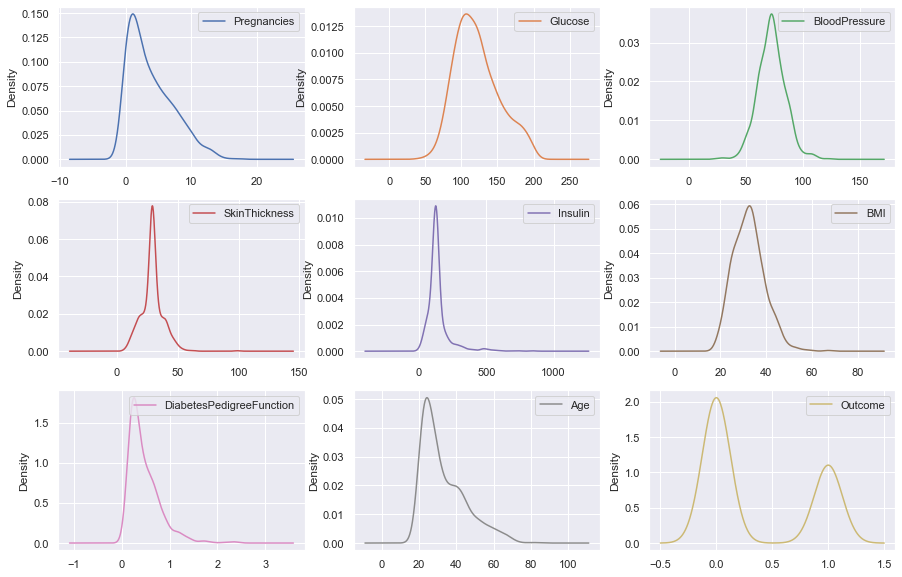

In [87]:
##  after outliers removed , but before cleaning nans the visualization

diabetes_data_copy.plot(kind= 'kde' , subplots=True, layout=(3,3), sharex=False, sharey=False, figsize=(15,10))

plt.show()

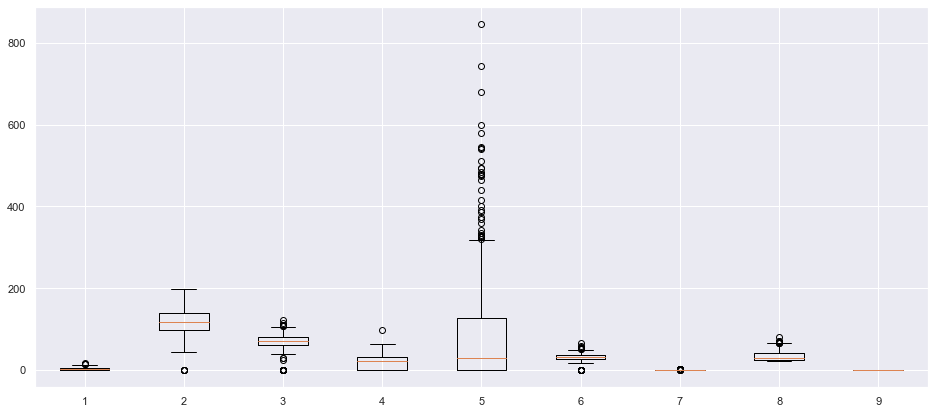

In [34]:
fig,ax=plt.subplots(1,1,figsize=(16,7))
ax.boxplot(diabetes_data)
plt.show()

In [49]:
# First quartile (Q1) 
Q1 = np.percentile(diabetes_data['BMI'], 15, interpolation = 'midpoint') 
  
# Third quartile (Q3) 
Q3 = np.percentile(diabetes_data['BMI'], 85, interpolation = 'midpoint') 
  
# Interquaritle range (IQR) 
IQR = Q3 - Q1 
print("Q1 = ",Q1)
print("Q3 = ",Q3)
print(IQR) 

Q1 =  24.85
Q3 =  39.25
14.399999999999999


In [50]:
(diabetes_data['BMI']>Q3).sum(),(diabetes_data['BMI']<Q1).sum()

(116, 116)

In [51]:
np.percentile(diabetes_data['BMI'], 98.5, interpolation = 'midpoint') 

49.05

In [54]:
# These are the top values which I am counting as outliers.
val = diabetes_data['BMI'].sort_values(ascending=False)
print(val[:8])
diabetes_data = diabetes_data[(diabetes_data['BMI']>50)==False]
diabetes_data.shape



177    67.1
445    59.4
673    57.3
125    55.0
120    53.2
303    52.9
193    52.3
247    52.3
Name: BMI, dtype: float64


(760, 9)

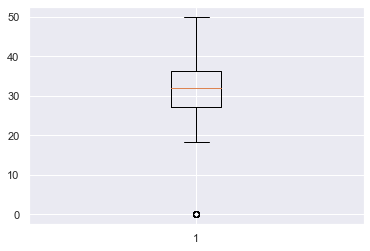

In [56]:
#So after removing outliers we are left with 760 rows. 

#Lets check removal of Outliers by plotting a boxplot.

plt.boxplot(diabetes_data['BMI'])
plt.show()

In [59]:
## Aiming to impute nan values for the columns in accordance with their distribution 
## basicaly this is recursive cell to replace the nan's and zeros for other columns to finalize the cleaned dataset

diabetes_data['Glucose'].fillna(diabetes_data_copy['Glucose'].mean(), inplace = True)
diabetes_data['BloodPressure'].fillna(diabetes_data_copy['BloodPressure'].mean(), inplace = True)
diabetes_data['SkinThickness'].fillna(diabetes_data_copy['SkinThickness'].median(), inplace = True)
diabetes_data['Insulin'].fillna(diabetes_data_copy['Insulin'].median(), inplace = True)
diabetes_data['BMI'].fillna(diabetes_data_copy['BMI'].median(), inplace = True)
diabetes_data.isna().sum()


Pregnancies                 0
Glucose                     0
BloodPressure               0
SkinThickness               0
Insulin                     0
BMI                         0
DiabetesPedigreeFunction    0
Age                         0
Outcome                     0
dtype: int64

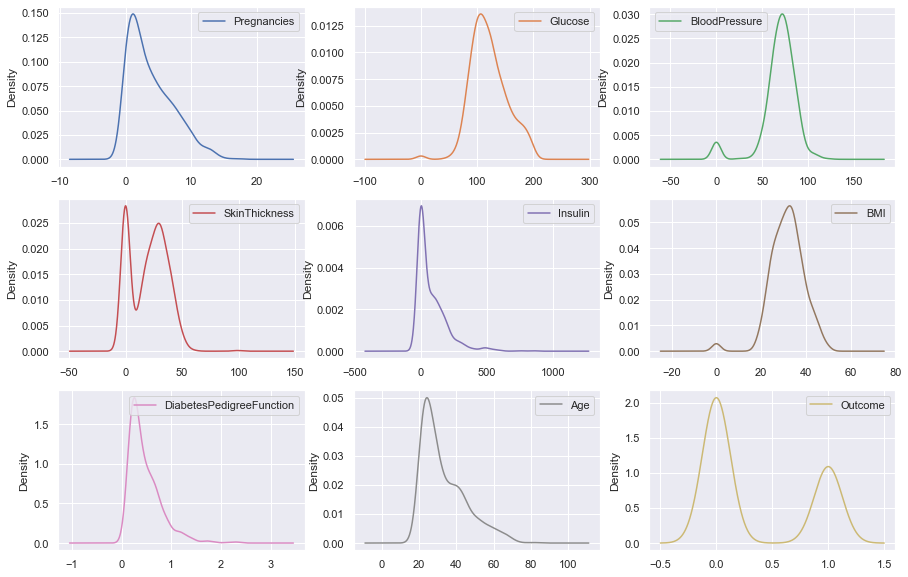

In [60]:
# here after cleansing the dataset we have plots 
diabetes_data.plot(kind= 'kde' , subplots=True, layout=(3,3), sharex=False, sharey=False, figsize=(15,10))
plt.show()


In [63]:
df=pd.DataFrame(diabetes_data)
dfupdated=pd.DataFrame(diabetes_data_copy)
print(diabetes_data.shape,diabetes_data_copy.shape)

(760, 9) (768, 9)


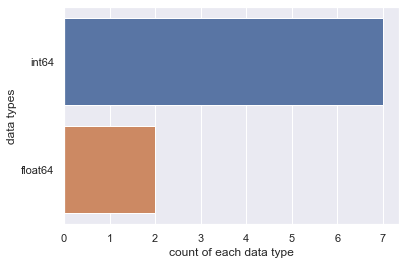

<class 'pandas.core.frame.DataFrame'>
Int64Index: 760 entries, 0 to 767
Data columns (total 9 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Pregnancies               760 non-null    int64  
 1   Glucose                   760 non-null    int64  
 2   BloodPressure             760 non-null    int64  
 3   SkinThickness             760 non-null    int64  
 4   Insulin                   760 non-null    int64  
 5   BMI                       760 non-null    float64
 6   DiabetesPedigreeFunction  760 non-null    float64
 7   Age                       760 non-null    int64  
 8   Outcome                   760 non-null    int64  
dtypes: float64(2), int64(7)
memory usage: 59.4 KB


In [65]:
## data type analysis
#plt.figure(figsize=(5,5))
#sns.set(font_scale=2)
sns.countplot(y=diabetes_data.dtypes.map(str) ,data=diabetes_data)
plt.xlabel("count of each data type")
plt.ylabel("data types")


plt.show()
diabetes_data.info(verbose=True)

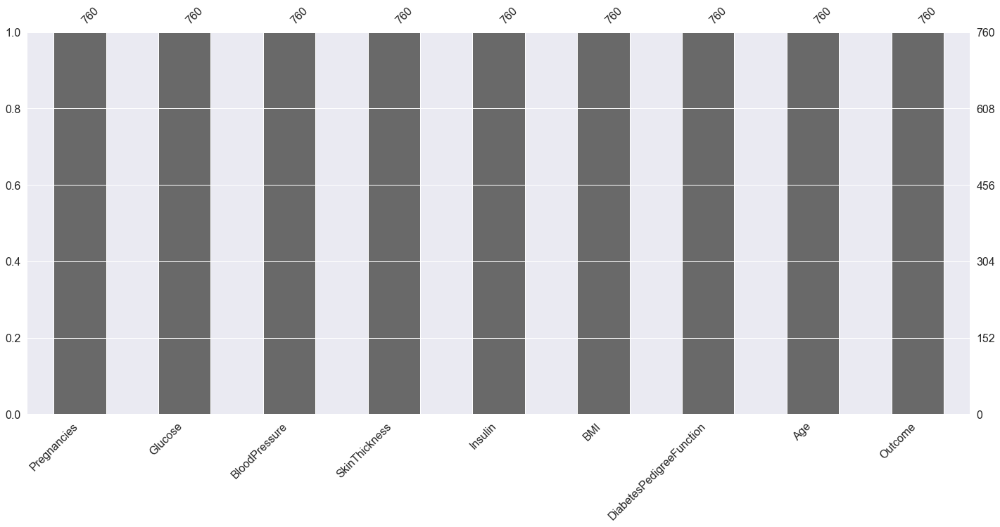

In [67]:
## null count analysis

p=msno.bar(diabetes_data)

The below graph shows that the data is biased towards datapoints having outcome value as 0 where it means that diabetes was not present actually. 
The number of non-diabetics is almost twice the number of diabetic patients
 0    498
1    262
Name: Outcome, dtype: int64


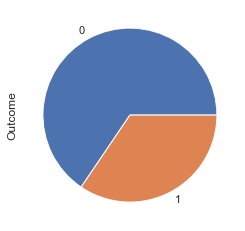

In [69]:
## checking the balance of the data by plotting the count of outcomes by their value
## here we get over view for the data of wether what majority is classified for 
diabetes_data.Outcome.value_counts().plot(kind="pie")
print("The below graph shows that the data is biased towards datapoints having outcome value as 0 where it means that diabetes was not present actually. \nThe number of non-diabetics is almost twice the number of diabetic patients\n",       diabetes_data.Outcome.value_counts())

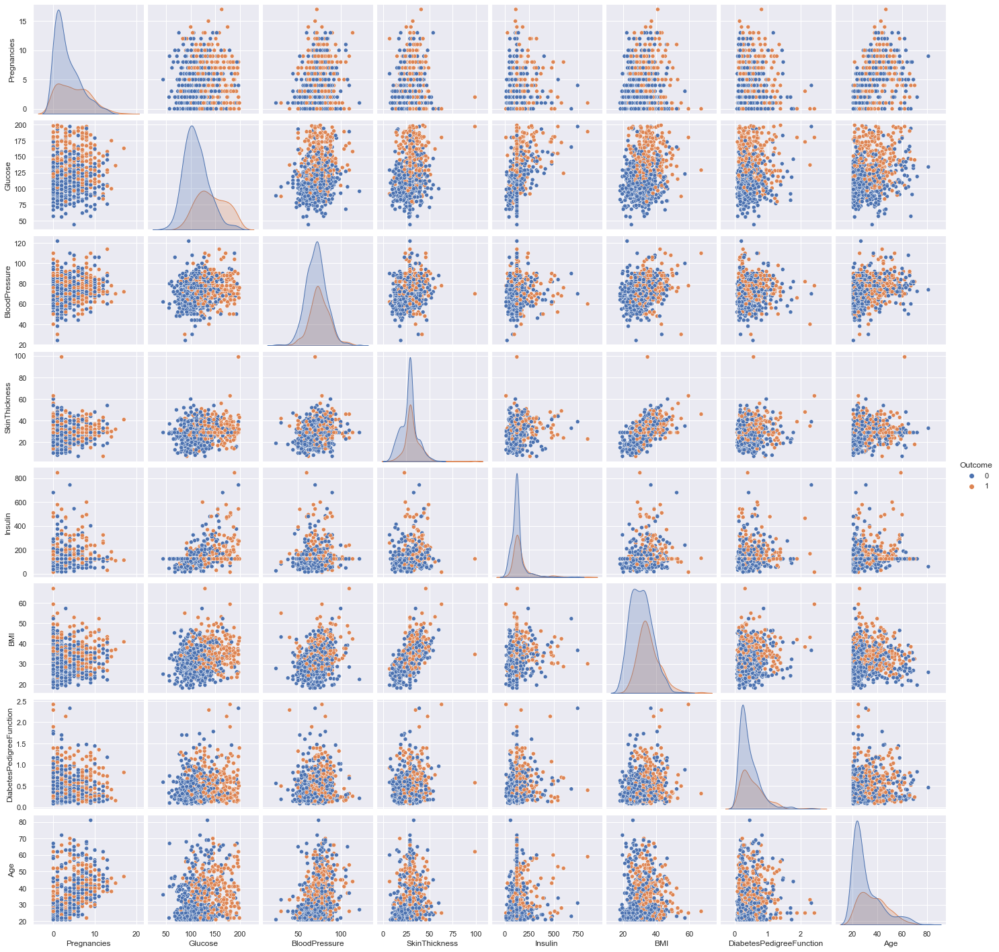

In [83]:
#Scatter matrix of uncleaned data

p=sns.pairplot(diabetes_data_copy, hue = 'Outcome')

#This pairs plot builds onto two basic figures, the histogram and the scatter plot. The histogram on the diagonal allows us to see the distribution of a single variable while the scatter plots on the upper and lower triangles show the relationship (or lack thereof)between two variables.

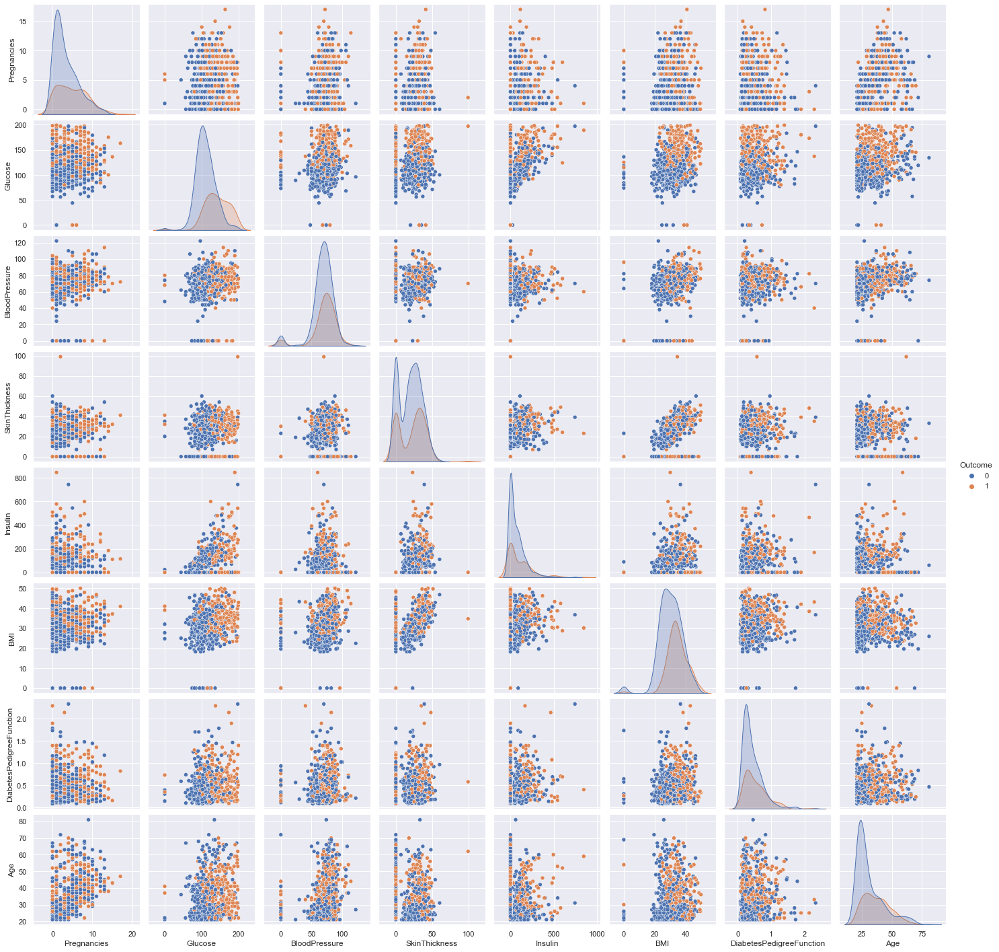

In [82]:
#Pair plot for clean data 

p=sns.pairplot(diabetes_data, hue = 'Outcome')

In [86]:
#Pearson's Correlation Coefficient: helps you find out the relationship between two quantities. It gives you the measure of the strength of association between two variables. 

#The value of Pearson's Correlation Coefficient can be between -1 to +1. 1 means that they are highly correlated and 0 means no correlation.

# A heat map is a two-d imensional representation of information with the help of colors. Heat maps can help the user visualize simple or complex information.

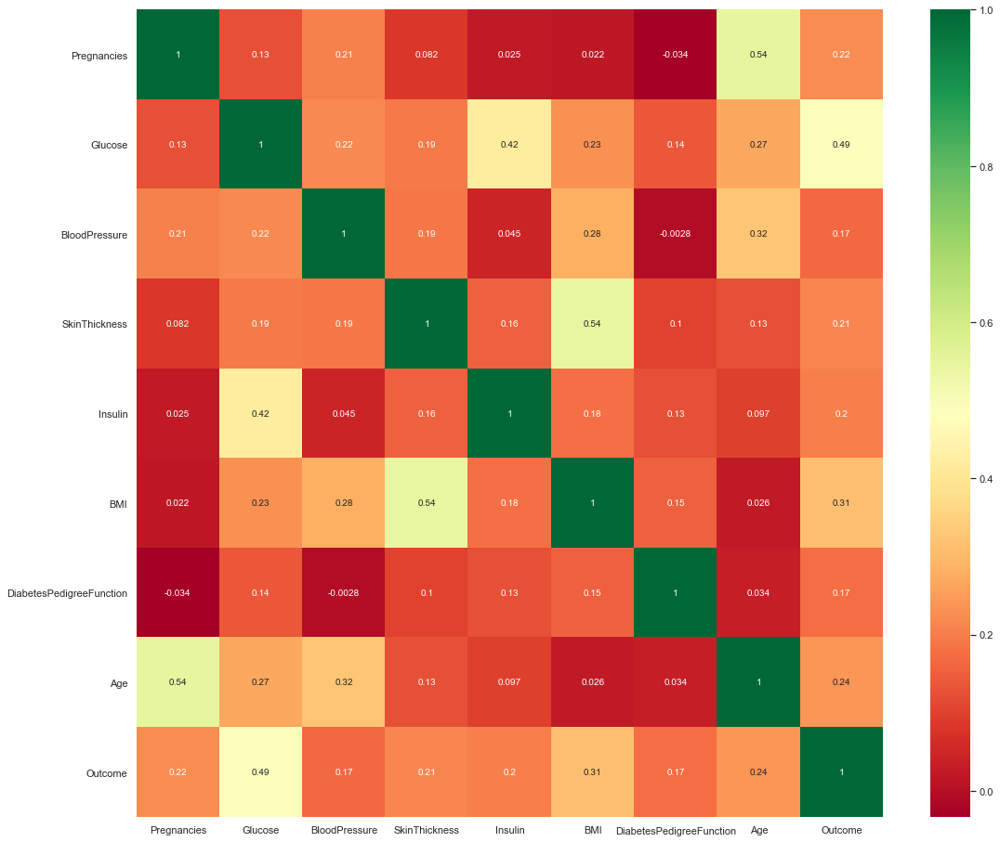

In [73]:
#Heatmap for clean data 
#Pearson's Correlation Coefficient: helps you find out the relationship between two quantities. It gives you the measure of the strength of association between two variables. 

#The value of Pearson's Correlation Coefficient can be between -1 to +1. 1 means that they are highly correlated and 0 means no correlation.

# A heat map is a two-dimensional representation of information with the help of colors. Heat maps can help the user visualize simple or complex information.

plt.figure(figsize=(18,16))  
p=sns.heatmap(diabetes_data.corr(), annot=True,cmap ='RdYlGn')


In [74]:
# core thing starts now !! 
# scaling the data data Z is rescaled such that μ = 0 and 𝛔 = 1, and is done through this formula: 𝙯= ( 𝙭(𝙞)-μ ) / 𝛔 
# Standardization refers to shifting the distribution of each attribute to have a mean of zero and a standard deviation of one (unit variance).
#It is useful to standardize attributes for a model that relies on the distribution of attributes such as Gaussian processes.

from sklearn.preprocessing import StandardScaler 
sc_X = StandardScaler()
X =  pd.DataFrame(sc_X.fit_transform(diabetes_data_copy.drop(["Outcome"],axis = 1),),
        columns=['Pregnancies', 'Glucose', 'BloodPressure', 'SkinThickness', 'Insulin',
       'BMI', 'DiabetesPedigreeFunction', 'Age'])

# Data rescaling is an important part of data preparation before applying machine learning algorithms.

X.head() 

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age
0,0.639947,0.865108,-0.033518,0.670643,-0.181541,0.166619,0.468492,1.425995
1,-0.844885,-1.206162,-0.529859,-0.012301,-0.181541,-0.852200,-0.365061,-0.190672
2,1.233880,2.015813,-0.695306,-0.012301,-0.181541,-1.332500,0.604397,-0.105584
3,-0.844885,-1.074652,-0.529859,-0.695245,-0.540642,-0.633881,-0.920763,-1.041549
4,-1.141852,0.503458,-2.680669,0.670643,0.316566,1.549303,5.484909,-0.020496


In [75]:
#X = diabetes_data.drop("Outcome",axis = 1)
y = diabetes_data_copy.Outcome  # assigning the label column"

In [76]:
# Test Train Split and Cross Validation methods

# Train Test Split : To have unknown datapoints to test the data rather than testing with the same points with which the model was trained. This helps capture the      model performance much better.

# Cross Validation: When model is split into training and testing it can be possible that specific type of data point may go entirely into either training or testing   portion. This would lead the model to perform poorly. Hence over-fitting and underfitting problems can be well avoided with cross validation techniques

# About Stratify : Stratify parameter makes a split so that the proportion of values in the sample produced will be the same as the proportion of values provided to    parameter stratify.

# For example, if variable y is a binary categorical variable with values 0 and 1 and there are 25% of zeros and 75% of ones, stratify=y will make sure that your       random split has 25% of 0's and 75% of 1's.


X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=40)

X_train.shape, X_test.shape, y_train.shape, y_test.shape
#print("X_train : \n\n{} \nX_test : \n\n{} \nY_train : \n\n{} \nY_test : \n\n{}".format(X_train,X_test,y_train,y_test))

((537, 8), (231, 8), (537,), (231,))

In [85]:
'''
Model The Data
Little Note - When it comes to data modeling, the beginner’s question is always, "what is the best machine learning algorithm?" To this the beginner must learn, the No Free Lunch Theorem (NFLT) of Machine Learning. In short, NFLT states, there is no super algorithm, that works best in all situations, for all datasets. So the best approach is to try multiple MLAs, tune them, and compare them for your specific scenario.
'''
models = []
models.append(('Logistic Regression              ', LogisticRegression()))
models.append(('Linear Discriminant Analysis     ', LinearDiscriminantAnalysis()))
models.append(('Random Forest Classifier         ', RandomForestClassifier()))
models.append(('KNeighbors Classifier            ', KNeighborsClassifier()))
models.append(('Decision Tree Classifier         ', DecisionTreeClassifier()))
models.append(('Gaussian Naive Bayes             ', GaussianNB()))
models.append(('Support vector machine Classifier', SVC()))
# evaluate each model in turn
results = []
names = []
scoring = 'accuracy'
for name, model in models:
    kfold = model_selection.KFold(n_splits=10)
    pipeline = make_pipeline(StandardScaler(), RandomForestClassifier())
    pipeline.fit(X_train, y_train)
    cv_results = model_selection.cross_val_score(pipeline, X, y, cv=kfold, scoring=scoring)
    results.append(cv_results)
    names.append(name)
    msg = "%s : | mean.Accuracy = %f | stdev.Accuracy = %f | max.Accuracy = %f" % (name, cv_results.mean()*100, cv_results.std()*100,cv_results.max()*100)
    print(msg," ~{%} \n")
    


Logistic Regression               : | mean.Accuracy = 76.302119 | stdev.Accuracy = 7.255269 | max.Accuracy = 87.012987  ~{%} 

Linear Discriminant Analysis      : | mean.Accuracy = 74.603554 | stdev.Accuracy = 6.687085 | max.Accuracy = 84.415584  ~{%} 

Random Forest Classifier          : | mean.Accuracy = 76.428571 | stdev.Accuracy = 5.883338 | max.Accuracy = 84.415584  ~{%} 

KNeighbors Classifier             : | mean.Accuracy = 76.038961 | stdev.Accuracy = 5.836180 | max.Accuracy = 84.415584  ~{%} 

Decision Tree Classifier          : | mean.Accuracy = 74.991456 | stdev.Accuracy = 7.654668 | max.Accuracy = 85.714286  ~{%} 

Gaussian Naive Bayes              : | mean.Accuracy = 75.391319 | stdev.Accuracy = 7.319863 | max.Accuracy = 85.714286  ~{%} 

Support vector machine Classifier : | mean.Accuracy = 76.693438 | stdev.Accuracy = 6.725956 | max.Accuracy = 84.415584  ~{%} 



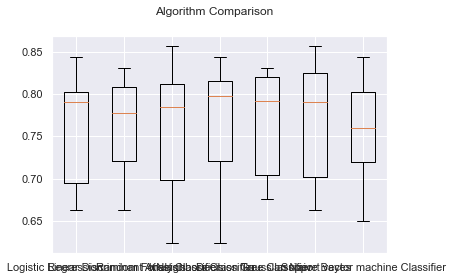

In [84]:
# boxplot algorithm comparison
fig = plt.figure()
fig.suptitle('Algorithm Comparison')
ax = fig.add_subplot(111)
plt.boxplot(results)
ax.set_xticklabels(names)
plt.show()